# MSIN0143 Programming for Business Analytics 
## Group S2
### Due 13 December 2022
### Word Count: 1997

# Table of Contents

## [1. Introduction](#introduction)
* [1.1 Business Problem](#business_problem)
* [1.2 Research Question](#research_qn)  

## [2. Exploratory Data Analysis (EDA) and Data Preparation](#eda_header)
* [2.1 Loading data and packages](#load)
* [2.2 EDA](#eda)
* [2.3 Cleaning](#cleaning)
    * [2.3.1 Removal](#removal)
    * [2.3.2 Creating Dummies](#dummies)


## 3. [Models](#models)
* [3.1 Linear Regression](#lr)
* [3.2 Random Forest](#rf)
* [3.3 Decision Tree](#dt)
* [3.4 XGBoost](#xgboost)
* [3.5 Summary](#summary)

     
## 4. [Conclusion and Recommendation](#conclusion_and_recommendation) 


## 5. [Limitations](#limitations)
* [5.1 General Limitations](#general_limit)
* [5.2 Model Limitations](#model_limit)

## 6. [References](#references)

## 7. [Appendix](#appendix)
* [7.1 Variable Definitions](#definitions)
* [7.2 Trello](#trello)
* [7.3 Meeting Minutes](#minutes)

## 1. Introduction <a class="anchor" id="introduction"></a>

### 1.1 Business Problem <a class="anchor" id="business_problem"></a>

**Background**

Music is a vital entertainment in our daily lives.

Whether a song will be popular is what every artist and entertainment agency is trying to speculate and willing to invest to identify. In a commercial perspective, a widely popular song carries substantial economic benefits, as well as higher social status specifically for artists. It seems that the success and popularity of a song are related to the subjective taste and evaluation of each individual, but can we predict a song's popularity from its technical features?

**Value Creation**

The rise of number of artists, ranging from traditional and non-traditional paths (e.g. TikTok) indicates the surged competition among the music industry. Hence, this analytical project will explore factors that affect a song’s popularity and help industry stakeholders predict whether a song will be popular. Essentially, new value creation opportunities emerge such that predictive models of popular songs can be marketed in this industry (Nijkamp, 2018).

**Methodology**

We build 4 predictive models to enable artists and other industry experts to use in order to create and market the next popular song.



### 1.2 Research Question <a class="anchor" id="research_qn"></a>

Taking music features into account, how popular can a song be?

## 2. Exploratory Data Analysis (EDA) and Data Preparation <a class="anchor" id="eda_header"></a>

To answer our question, we will use data from the Spotify API, sourced through Kaggle (Spotify API, 2021). The dataset includes songs up until April 4, 2020 and consists of 50005 records, each corresponding to a track with 18 qualitative and quantitative attributes. 

We will explore the data, finding any correlations within variables. Then, we will clean the data by doing the following: 
1. Removing empty rows
2. Removing redundant variables
3. Creating dummy variables

### 2.1 Loading Data and Packages <a class="anchor" id="load"></a>

In [236]:
from IPython.core.interactiveshell import InteractiveShell     
InteractiveShell.ast_node_interactivity = "all"

# import libraries and modules needed for the project
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import statsmodels.api as sm
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor
import sklearn.metrics
from sklearn import tree

In [237]:
# Loading the data into a dataframe:
data= pd.read_csv('/project/EDA_Data_cleaning/music_genre.csv')

# Displaying data:
data.head()

,instance_id,artist_name,track_name,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,obtained_date,valence,music_genre
0,32894.0,Röyksopp,Röyksopp's Night Out,27.0,0.00468,0.652,-1.0,0.941,0.79200,A#,0.115,-5.201,Minor,0.0748,100.889,4-Apr,0.759,Electronic
1,46652.0,Thievery Corporation,The Shining Path,31.0,0.01270,0.622,218293.0,0.890,0.95000,D,0.124,-7.043,Minor,0.0300,115.00200000000001,4-Apr,0.531,Electronic
2,30097.0,Dillon Francis,Hurricane,28.0,0.00306,0.620,215613.0,0.755,0.01180,G#,0.534,-4.617,Major,0.0345,127.994,4-Apr,0.333,Electronic
3,62177.0,Dubloadz,Nitro,34.0,0.02540,0.774,166875.0,0.700,0.00253,C#,0.157,-4.498,Major,0.2390,128.014,4-Apr,0.270,Electronic
4,24907.0,What So Not,Divide & Conquer,32.0,0.00465,0.638,222369.0,0.587,0.90900,F#,0.157,-6.266,Major,0.0413,145.036,4-Apr,0.323,Electronic


There are 11 numeric and 7 non-numeric variables. All variable descriptions can be found in the appendix.

### 2.2 EDA <a class="anchor" id="eda"></a>

In [81]:
# Understanding the data further: 
print(data.shape)
print(data.columns)
print(data.info())

(50005, 18)
Index(['instance_id', 'artist_name', 'track_name', 'popularity',
       'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'key', 'liveness', 'loudness', 'mode',
       'speechiness', 'tempo', 'obtained_date', 'valence', 'music_genre'],
      dtype='object')
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50005 entries, 0 to 50004
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   instance_id       50000 non-null  float64
 1   artist_name       50000 non-null  object 
 2   track_name        50000 non-null  object 
 3   popularity        50000 non-null  float64
 4   acousticness      50000 non-null  float64
 5   danceability      50000 non-null  float64
 6   duration_ms       50000 non-null  float64
 7   energy            50000 non-null  float64
 8   instrumentalness  50000 non-null  float64
 9   key               50000 non-null  object 
 10  liveness          

In [82]:
# Understanding data for all datatypes, not just numeric ones: 
data.describe(include=['object', 'bool'])

,artist_name,track_name,key,mode,tempo,obtained_date,music_genre
count,50000,50000,50000,50000,50000,50000,50000
unique,6863,41699,12,2,29394,5,10
top,empty_field,Home,G,Major,?,4-Apr,Electronic
freq,2489,16,5727,32099,4980,44748,5000


Our variable of interest, popularity, is measured on a scale from 0 and 100, where 100 is the most popular.

Sorting based on popularity, we can see that the top three songs at the time of data collection are "Wow" and "Sunflower" by Post Malone and "Middle Child" by J. Cole.

In [83]:
# Sorting by popularity to see the top tracks: 
data.sort_values(by= 'popularity', ascending= False).head() 

,instance_id,artist_name,track_name,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,obtained_date,valence,music_genre
26239,84744.0,Post Malone,Wow.,99.0,0.163,0.833,149520.0,0.539,0.000002,B,0.1010,-7.399,Minor,0.1780,99.947,4-Apr,0.385,Rap
25194,59859.0,Post Malone,Sunflower - Spider-Man: Into the Spider-Verse,97.0,0.556,0.760,158040.0,0.479,0.000000,D,0.0703,-5.574,Major,0.0466,89.911,4-Apr,0.913,Rap
47024,89355.0,J. Cole,MIDDLE CHILD,96.0,0.149,0.837,213594.0,0.364,0.000000,G#,0.2710,-11.713,Major,0.2760,123.984,4-Apr,0.463,Hip-Hop
105,49721.0,DJ Snake,"Taki Taki (with Selena Gomez, Ozuna & Cardi B)",96.0,0.153,0.841,212500.0,0.798,0.000003,C#,0.0618,-4.206,Minor,0.2290,95.948,4-Apr,0.591,Electronic
47596,86123.0,Paulo Londra,Adan y Eva,95.0,0.323,0.767,258639.0,0.709,0.000000,C#,0.0676,-4.470,Major,0.3360,?,4-Apr,0.720,Hip-Hop


The bar chart below visualises the dispersion of data: the shape of the data follows a generic bell curve, with most tracks falling between 20 and 80. It is symmetrically distributed.

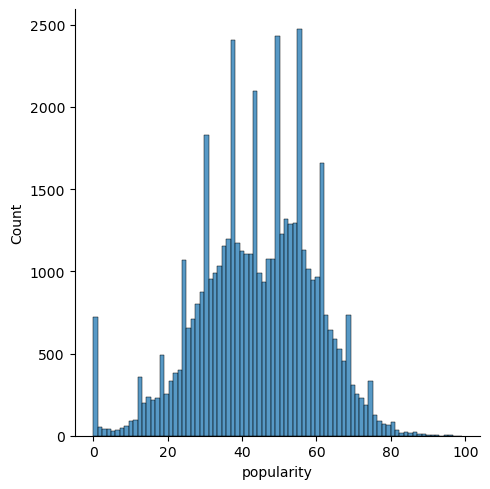

In [84]:
# Creating vertical bar chart by popularity: 
sns.displot(data['popularity'])

Skewness and Kurtosis can help to measure the extent of asymmetry of the data.

In [85]:
print('Skewness: %f' % data['popularity'].skew())
print('Kurtosis: %f' % data['popularity'].kurt())

Skewness: -0.304791
Kurtosis: 0.013461


Skewness of -0.305 is low, meaning there is more weight in the right tail of the data, and the tail is longer on the left, which we can see from the bar chart.

Kurtosis of 0.013 is also low (Platykurtic), meaning the data has thin tails and a low frequency of outliers. 

We can also group the data by different variables to see more descriptive statistics. 

In [86]:
column_to_show=['popularity', 'acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'loudness', 'speechiness', 'valence']

# Grouping by different genres to see each genre's features descriptive statistics
data_by_genre=data.groupby(['music_genre'])[column_to_show].describe() 

# Grouping by different keys to see each key's features descriptive statistics
data_by_key= data.groupby(data['key'])[column_to_show].describe() 
data_by_mode= data.groupby(data['mode'])[column_to_show].describe()
print(data_by_genre)

            popularity                                                     \
                 count     mean        std   min    25%   50%   75%   max   
music_genre                                                                 
Alternative     5000.0  50.2242   7.664260   0.0  45.00  49.0  55.0  83.0   
Anime           5000.0  24.2716   9.675151   0.0  17.00  23.0  30.0  65.0   
Blues           5000.0  34.8040   9.716422   0.0  28.75  33.0  39.0  80.0   
Classical       5000.0  29.3158  14.100519   0.0  25.00  32.0  38.0  68.0   
Country         5000.0  46.0100   9.771540   0.0  39.00  44.0  52.0  82.0   
Electronic      5000.0  38.1118   9.715378   0.0  31.00  37.0  44.0  96.0   
Hip-Hop         5000.0  58.3996   8.302271  18.0  52.00  57.0  63.0  96.0   
Jazz            5000.0  40.9286   9.517333   0.0  36.00  40.0  46.0  79.0   
Rap             5000.0  60.4974   8.160620  14.0  55.00  59.0  65.0  99.0   
Rock            5000.0  59.6412   7.359110   0.0  55.00  59.0  64.0  90.0   

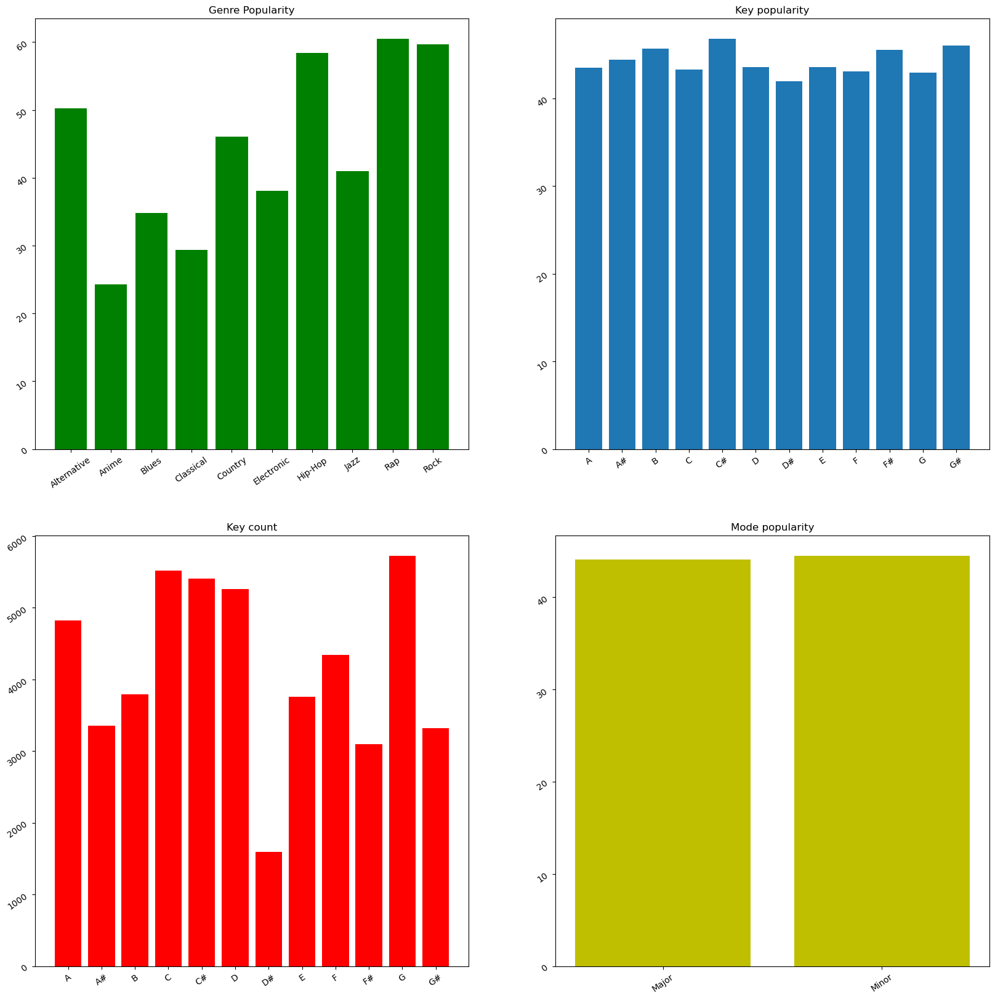

In [87]:
pop_mean_genre= pd.DataFrame(data_by_genre['popularity']['mean'])
key_pop=pd.DataFrame(data_by_key['popularity']['mean'])
key_count=pd.DataFrame(data_by_key['popularity']['count'])
mode_popularity= pd.DataFrame(data_by_mode['popularity']['mean'])
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2)
fig.set_size_inches(20,20)
 
#plt.xticks(rotation=45)
# Plotting a bar chart of the popularity in each genre
ax1.bar(pop_mean_genre.index, pop_mean_genre['mean'], color='g')
ax1.tick_params(labelrotation=35)
ax1.set_title('Genre Popularity') # plot the bar chart of the popularity in each genre

# Plotting a bar chart of the popularity by keys
ax2.bar(key_pop.index, key_pop['mean'])
ax2.tick_params(labelrotation=35)
ax2.set_title('Key popularity') # plot the bar chart of the popularity by keys

# Plotting a bar chart to visualise the number of songs in each keys
ax3.bar(key_count.index, key_count['count'], color='r')
ax3.tick_params(labelrotation=35)
ax3.set_title('Key count') # plot the bar chart to see how many songs there are in each keys

# Plotting a bar chart to see the popularity of each mode
ax4.bar(data_by_mode.index, mode_popularity['mean'], color='y')
ax4.tick_params(labelrotation=35)
ax4.set_title('Mode popularity') # plot the bar chart to see hthe popularity of each mode
plt.show();

From the visualisations, Rap and Rock are the most popular genres, while Anime and Classical are the least popular genres. 

We could potentially target stakeholders in the music industry who are looking to create music in the genres that fall in the middle. 

We can also see that there are no significant differences between Key popularity or Mode popularity. 

Therefore, since such columns do not represent interest in our objectives, we can drop them. 

To see if there are any correlations between the variables:

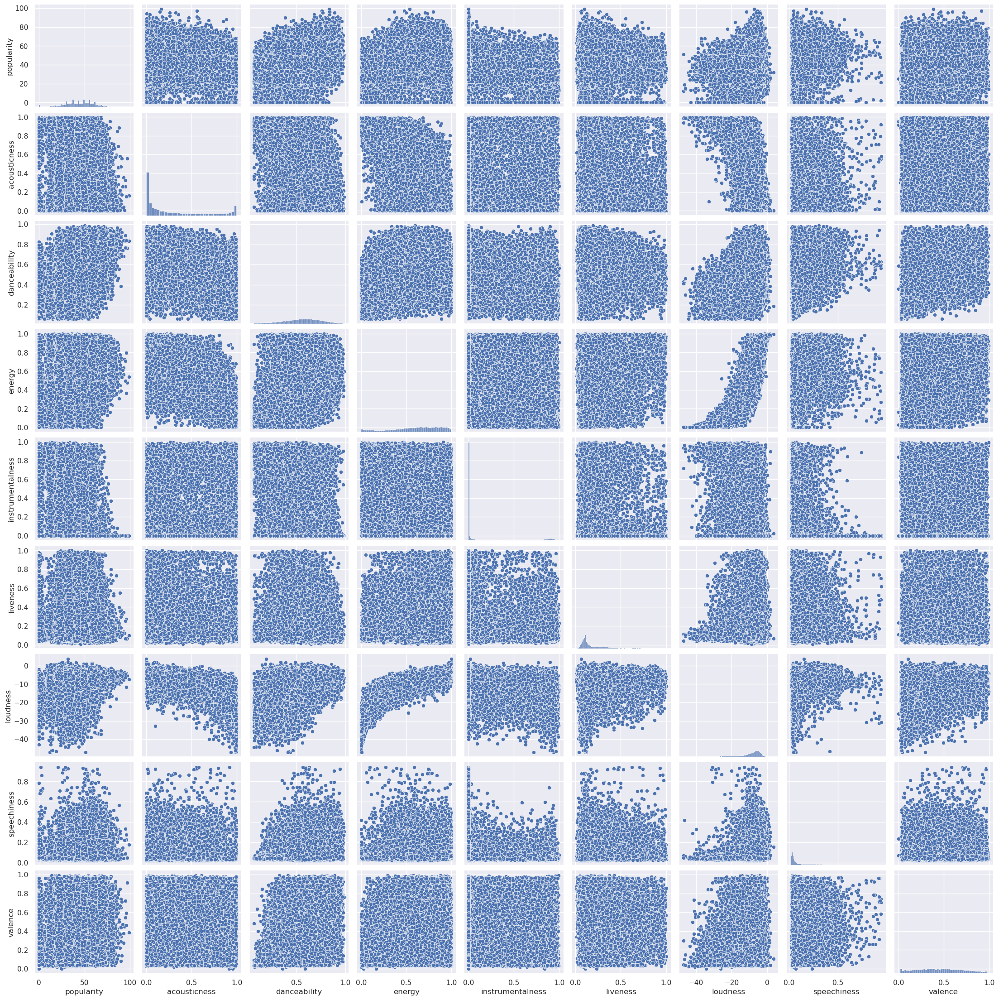

In [33]:
# Plotting the relation between each variable to see any correlation:
sns.set()
sns.pairplot(data[column_to_show], height=2.5)
plt.show();

/tmp/ipykernel_134/3695327198.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_mat= data.corr()


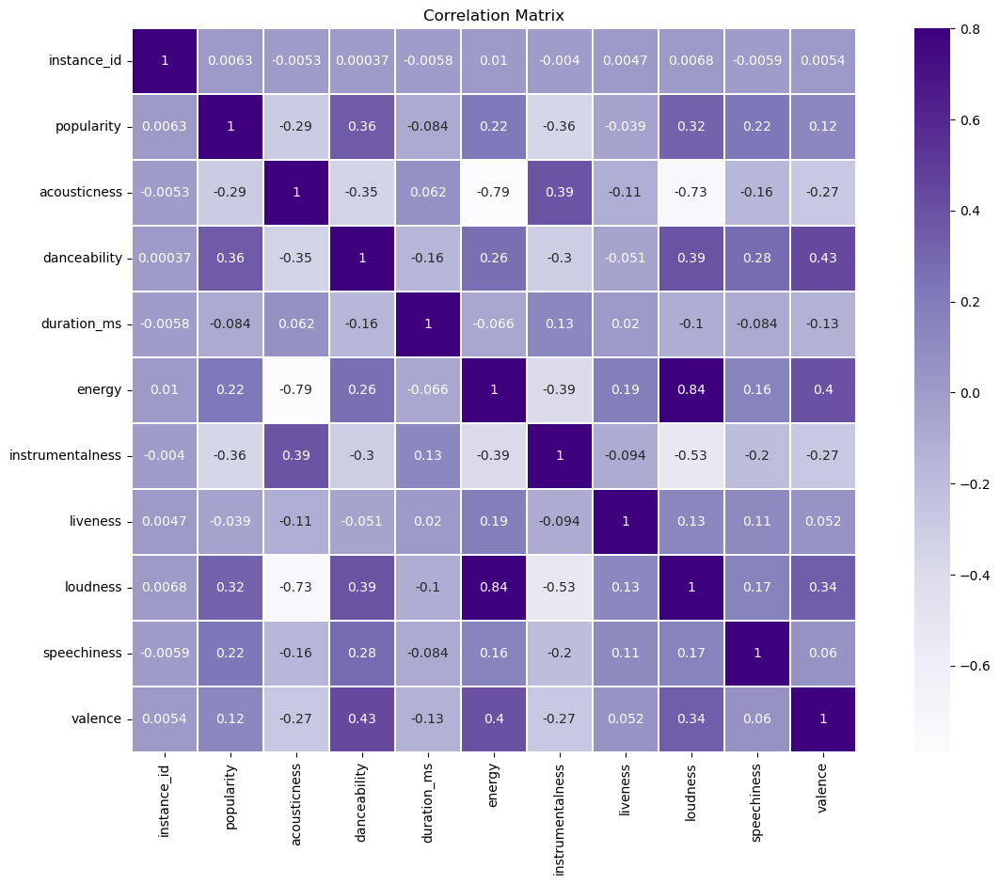

In [88]:
# Correlation matrix:
corr_mat= data.corr()
f, ax= plt.subplots(figsize=(16, 10))
sns.heatmap(corr_mat,annot=True, vmax=0.8, linewidth=0.3, square=True,cmap='Purples')
ax.set_title("Correlation Matrix") 
plt.show();

We can see that most variables are not highly correlated, with 3 exceptions: 
1. Acousticness and loudness: -0.73
2. Acousticness and energy: -0.79
3. Energy and loudness: 0.84

This is in line with our preconceptions as a loud track is more likely to be energetic, and acoustic tracks are more likely to be quieter. 

While these variables are correlated, we decided not to drop them as multicollinearity does not affect predictions, precision of the predictions, and the goodness-of-fit statistics (Frost, 2022). 

### 2.3 Cleaning <a class="anchor" id="cleaning"></a>

#### 2.3.1 Removal <a class="anchor" id="removal"></a>

In [238]:
# Missing data:
total= data.isnull().sum().sort_values(ascending =False) 

# Amount of data originally:
count= data.isnull().count() 
missing_value= pd.concat([total, count], axis=1, keys=['total', 'count'])
print(missing_value)

                  total  count
instance_id           5  50005
artist_name           5  50005
valence               5  50005
obtained_date         5  50005
tempo                 5  50005
speechiness           5  50005
mode                  5  50005
loudness              5  50005
liveness              5  50005
key                   5  50005
instrumentalness      5  50005
energy                5  50005
duration_ms           5  50005
danceability          5  50005
acousticness          5  50005
popularity            5  50005
track_name            5  50005
music_genre           5  50005


In total, there are 5 empty rows in the dataset and we will remove them. 

We are also dropping columns that we do not need, such as 'instance_id', 'track_name' etc. because they are mostly non-numeric data and we believe they do not provide predictive power. 

In [90]:
# Finding the index of the missing data of 'artist_name':
x= (data[data['artist_name'].isnull()]).index 

# Drop the index of the missing data: 
data_no_missing= data.drop(x,0) 

# Dropping columns: 'loudness' is dropped as it is highly correlated to energy
data_no_missing=data_no_missing.drop(columns=['instance_id', 'track_name', 'obtained_date', 'duration_ms', 'artist_name', 'key', 'mode'], axis=1) 
data_no_missing.shape

/tmp/ipykernel_134/3037842367.py:5: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  data_no_missing= data.drop(x,0)


(50000, 11)

In [91]:
# Confirm if any missing data remains. 
# Find out the missing data is all in the same rows.
total_new= data_no_missing.isnull().sum().sort_values(ascending =False) 
print(total_new) 

popularity          0
acousticness        0
danceability        0
energy              0
instrumentalness    0
liveness            0
loudness            0
speechiness         0
tempo               0
valence             0
music_genre         0
dtype: int64


We also have to remove the rows that contain "?" values in the column Tempo and convert the datatype of Tempo from object to numeric. 

In [92]:
# Finding the index of the '?' data from 'tempo': 
t=(data_no_missing[data_no_missing['tempo']=='?']).index 

# Drop the value of '?' in tempo
data_no_missing=data_no_missing.drop(t,axis=0) 

In [93]:
# Ensuring that there are no more '?' values in 'tempo': 
# Changing the datatype of tempo from object to numeric: 
data_no_missing['tempo']=pd.to_numeric(data_no_missing['tempo'])
data_no_missing['tempo'].info

<bound method Series.info of 0        100.889
1        115.002
2        127.994
3        128.014
4        145.036
          ...   
50000     98.028
50001    122.043
50002    131.079
50003     75.886
50004     99.201
Name: tempo, Length: 45020, dtype: float64>

In [94]:
data_no_missing['tempo'].value_counts()

140.007    17
120.000    17
100.003    16
100.002    15
130.016    15
           ..
137.046     1
136.378     1
93.041      1
113.982     1
99.201      1
Name: tempo, Length: 29393, dtype: int64

In [95]:
# Confirm new shape of the cleaned dataset:
data_no_missing.shape

(45020, 11)

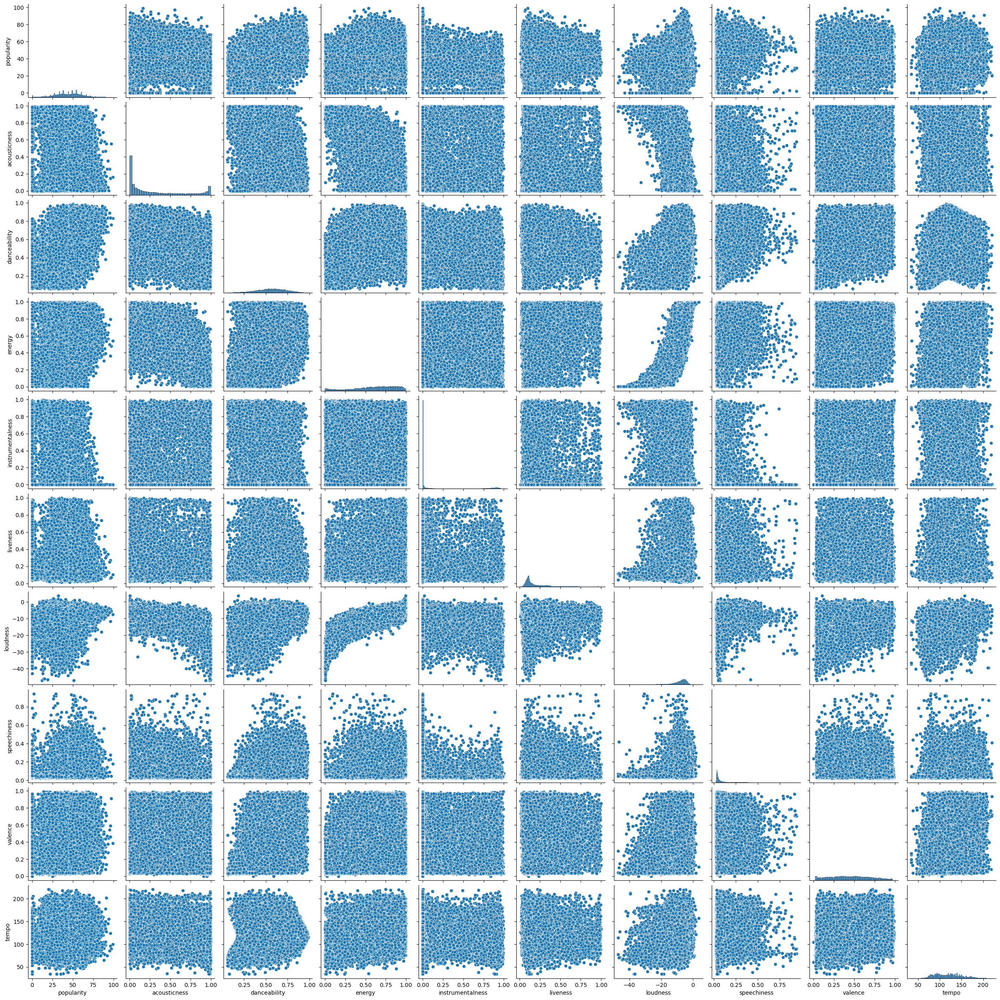

In [60]:
# Check the relation of variables again
# Tempo is added as it is now numeric:
column_to_show=['popularity', 'acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'loudness', 'speechiness', 'valence', 'tempo']
sns.pairplot(data_no_missing[column_to_show], height=2.5) 
plt.show();

In [96]:
# Dataset so far: 
from IPython.display import display
display(data_no_missing)

,popularity,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,music_genre
0,27.0,0.00468,0.652,0.941,0.79200,0.115,-5.201,0.0748,100.889,0.759,Electronic
1,31.0,0.01270,0.622,0.890,0.95000,0.124,-7.043,0.0300,115.002,0.531,Electronic
2,28.0,0.00306,0.620,0.755,0.01180,0.534,-4.617,0.0345,127.994,0.333,Electronic
3,34.0,0.02540,0.774,0.700,0.00253,0.157,-4.498,0.2390,128.014,0.270,Electronic
4,32.0,0.00465,0.638,0.587,0.90900,0.157,-6.266,0.0413,145.036,0.323,Electronic
...,...,...,...,...,...,...,...,...,...,...,...
50000,59.0,0.03340,0.913,0.574,0.00000,0.119,-7.022,0.2980,98.028,0.330,Hip-Hop
50001,72.0,0.15700,0.709,0.362,0.00000,0.109,-9.814,0.0550,122.043,0.113,Hip-Hop
50002,51.0,0.00597,0.693,0.763,0.00000,0.143,-5.443,0.1460,131.079,0.395,Hip-Hop
50003,65.0,0.08310,0.782,0.472,0.00000,0.106,-5.016,0.0441,75.886,0.354,Hip-Hop


Due to the different ranges of units for many variables, we standardise and normalise numerical input variables with a scaler. Our algorithms will perform better by scaling numerical input variables to a standard range. 

In [97]:
# Scaling the data due to different range of units: selecting the columns to scale 
column_to_scale= ['acousticness','danceability','energy','instrumentalness','liveness','speechiness','tempo', 'valence'] 
scaler = StandardScaler() 

# Scaling the data:
data_no_missing[column_to_scale] = scaler.fit_transform(data_no_missing[column_to_scale]) 

# Seeing the scaled dataset:
print(data_no_missing)

       popularity  acousticness  danceability    energy  instrumentalness  \
0            27.0     -0.884378      0.522585  1.290882          1.872550   
1            31.0     -0.860885      0.354853  1.098070          2.357446   
2            28.0     -0.889123      0.343671  0.587686         -0.521854   
3            34.0     -0.823684      1.204697  0.379752         -0.550303   
4            32.0     -0.884466      0.444310 -0.047459          2.231618   
...           ...           ...           ...       ...               ...   
50000        59.0     -0.800251      1.981858 -0.096607         -0.558068   
50001        72.0     -0.438199      0.841277 -0.898099         -0.558068   
50002        51.0     -0.880599      0.751820  0.617931         -0.558068   
50003        65.0     -0.654668      1.249426 -0.482231         -0.558068   
50004        67.0     -0.599306      1.696713  0.160475         -0.558068   

       liveness  loudness  speechiness     tempo   valence music_genre  
0 

#### 2.3.2 Creating Dummies <a class="anchor" id="dummies"></a>

From visualising the data, we know that the music genre of a track affects its popularity. Therefore, we have to include dummy variables for all music genres and concatenate it into the dataset. 

In [98]:
# In order to include music genre in our variables, we turn music genre into dummy variables:
data_new=data_no_missing
genre_dummies=pd.get_dummies(data_new['music_genre'])

# Concat the dummy variables to data_no_missing: 
data_new=pd.concat([data_new, genre_dummies], axis=1) 

# Seeing the finalised dataset:
print(data_new)

       popularity  acousticness  danceability    energy  instrumentalness  \
0            27.0     -0.884378      0.522585  1.290882          1.872550   
1            31.0     -0.860885      0.354853  1.098070          2.357446   
2            28.0     -0.889123      0.343671  0.587686         -0.521854   
3            34.0     -0.823684      1.204697  0.379752         -0.550303   
4            32.0     -0.884466      0.444310 -0.047459          2.231618   
...           ...           ...           ...       ...               ...   
50000        59.0     -0.800251      1.981858 -0.096607         -0.558068   
50001        72.0     -0.438199      0.841277 -0.898099         -0.558068   
50002        51.0     -0.880599      0.751820  0.617931         -0.558068   
50003        65.0     -0.654668      1.249426 -0.482231         -0.558068   
50004        67.0     -0.599306      1.696713  0.160475         -0.558068   

       liveness  loudness  speechiness     tempo   valence  ... Alternative

## 3. Models <a class="anchor" id="models"></a>

Since popularity is a continuous variable, we cannot do classifications, and cannot calculate accuracies. Instead, we will be doing regression. 

The Mean Squared Error (MSE) will be used to evaluate the performance of the models. It will function as a proxy for the accuracy of our models. 

The lower the MSE, the closer the forecast is to the actual, and indicates a better fit of the model.

In [270]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.model_selection import KFold

We create functions that will help us generate our MSE/RMSE easily. 

In [99]:
# Defining a function that returns a dataframe containing MSE and RMSE of that model:
def train_model(model_name, model, X_train, y_train):
    model.fit(X_train, y_train)
    neg_mse= cross_val_score(model, X_train, y_train, scoring='neg_mean_squared_error', cv=4, n_jobs=-1).mean()
    rmse=(-neg_mse)**0.5
    print('Training Result')
    training_model = pd.DataFrame({'Model':['{}'.format(model_name)],
                                'MSE': [abs(neg_mse)],
                                'RMSE': [rmse]
    })
    return training_model

In [100]:
# Defining a function that returns the adjusted R2 value:
def adjusted_r2(r2_score, X_test, y_test, y_pred):
    adjusted_r2= 1-(1-r2_score)*((len(X_test)-1)/(len(X_test)-X_test.shape[1]-1))
    return adjusted_r2

In [101]:
# Defining a function that returns a dataframe of the various variables for that model:
def model_results(model_name, model, X_train, y_train, X_test, y_test):
    model_train_predict= model.predict(X_train)
    model_test_predict= model.predict(X_test)
    model_train_r2= r2_score(y_train, model_train_predict)
    model_test_r2 =r2_score(y_test, model_test_predict)
    model_train_adjusted_r2= adjusted_r2(r2_score=model_train_r2, X_test=X_test, y_test= y_test, y_pred=model_train_predict)
    model_test_adjusted_r2= adjusted_r2(r2_score=model_test_r2, X_test=X_test, y_test=y_test, y_pred= model_test_predict)
    kfold= KFold(n_splits=5, random_state=1, shuffle= True)
    cv_results= cross_val_score(model, X_train, y_train, cv=kfold, scoring='neg_mean_squared_error', n_jobs=-1)
    rmse=((-cv_results).mean())**0.5

    model_results =pd.DataFrame({'algorithm': ['{}'.format(model_name)],
                                'CV_error': [-cv_results.mean()],
                                'CV_rmse':[rmse],
                                'training_error':[mean_squared_error(model_train_predict, y_train)],
                                'test_error':[mean_squared_error(model_test_predict, y_test)],
                                'train_adjusted_r2':[model_train_adjusted_r2],
                                'test_adjusted_r2':[model_test_adjusted_r2]
    })
    return model_results

### 3.1 Linear Regression <a class="anchor" id="lr"></a>

We will create a Linear Regression (LR) model. This model offers the most interpretability, which makes it easier for music creators to create music based on the variables that have high coefficients. 

In [195]:
# Preparing data for Linear Regression: 
data_LR=data_new.copy()

# To avoid the dummy variable trap, we will drop 1 dummy variable, "Anime" to see how other genres compare to it       
data_LR.drop(['music_genre', 'Anime'], inplace= True, axis=1) 

# Declaring our outcome variable, y, 'popularity':
y_lr =data_LR['popularity'] 

# Setting our predictors, x (independent variables):
x_lr =data_LR[['acousticness','danceability','energy','instrumentalness','liveness','loudness','speechiness','tempo', 'valence',
           'Alternative',  'Rock',  'Blues', 'Classical',  'Country',  'Electronic',  'Hip-Hop',  'Jazz',  'Rap']] 

# Splitting the dataset into training (70%) and test set (30%):
x_train_lr, x_test_lr, y_train_lr, y_test_lr= train_test_split(x_lr,y_lr, test_size= 0.3, random_state=666)

In [196]:
# Getting the MSE and RMSE of the LR model:
LR = train_model('Linear Regression', LinearRegression(), X_train=x_train_lr, y_train=y_train_lr)
LR

Training Result


,Model,MSE,RMSE
0,Linear Regression,91.243316,9.552137


In [170]:
# Statsmodel: 
# Visualising the LR: 
# Adding the constant to the model: 
x_train_lr=sm.add_constant(x_train_lr) 

# Building the model: 
model=sm.OLS(y_train_lr,x_train_lr).fit() 
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:             popularity   R-squared:                       0.625
Model:                            OLS   Adj. R-squared:                  0.625
Method:                 Least Squares   F-statistic:                     2919.
Date:                Mon, 12 Dec 2022   Prob (F-statistic):               0.00
Time:                        00:56:02   Log-Likelihood:            -1.1582e+05
No. Observations:               31514   AIC:                         2.317e+05
Df Residuals:                   31495   BIC:                         2.318e+05
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const               25.2942      0.245  

From the LR, we have a few interesting insights:
- Danceability is +0.3823, which is in line with our assumptions that a song that can be danced to is more likely to be played, therefore increasing its' popularity. 


- Music genres like "Rap" and "Rock", when compared to "Anime",  have a much higher impact on the popularity of a given song. This is in line with our assumptions, as well as the visualisations. 


- Valence has a negative coefficient of -0.1296, and P>|t| = 0.062, which is more than 5%. It goes against our assumptions that a song that is happier (higher valence) is associated with a decrease in popularity. However, this could be a limitation of our model. In reality, we assume that this is not the case as whether a song is happy or sad both influences its popularity. If Spotify had variables exclusively for happiness and another for sadness, we could potentially see that both variables (sad and happy) are statistically significant. 

The model has an adjusted R-squared of 62.5% which shows that the variables explain 62.5% of the variation in popularity. 

### 3.2 Random Forest <a class="anchor" id="rf"></a>
A supervised, machine-learning algorithm

In [171]:
y =data_new['popularity'] 

# Setting our predictors (independant variables), x:
x =data_new[['acousticness','danceability','energy','instrumentalness','liveness','loudness','speechiness','tempo', 'valence',
           'Alternative',  'Rock',  'Blues', 'Classical',  'Country',  'Electronic',  'Hip-Hop',  'Jazz',  'Rap', 'Anime']] 

# Splitting the dataset into training (70%) and test set (30%):
x_train, x_test, y_train, y_test= train_test_split(x,y, test_size= 0.3, random_state=666)

In [242]:
# Training the RF model using default parameters:  
untuned_rf = train_model('Untuned RF', RandomForestRegressor(n_jobs=-1, random_state=666), X_train=x_train, y_train=y_train)
untuned_rf

Training Result


,Model,MSE,RMSE
0,Untuned RF,88.141978,9.388396


In [248]:
# In order to achieve a better RF model, we can find out the parameters:
param_grid = {
    "n_estimators" : [1000], #number of trees in the forest
    "max_depth" : list(range(5,11)),  #maximum number of levels in each decision tree
    "min_samples_split" : [ 5, 10, 15],  #minimum number of data points placed in a node before the node is split
    "min_samples_leaf" : [2, 4, 6, 8]  #minimum number of data points alowed in a lead node 
}

rf_grid = GridSearchCV(RandomForestRegressor(n_jobs=-1), param_grid = param_grid,
                     scoring = 'neg_mean_squared_error', cv = 3)

# Fitting the RF model:
rf_grid.fit(x_train, y_train)

# The best parameters are: 
print(rf_grid.best_params_)

GridSearchCV(cv=3, estimator=RandomForestRegressor(n_jobs=-1),
             param_grid={'max_depth': [5, 6, 7, 8, 9, 10],
                         'min_samples_leaf': [2, 4, 6, 8],
                         'min_samples_split': [5, 10, 15],
                         'n_estimators': [1000]},
             scoring='neg_mean_squared_error')

{'max_depth': 10, 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 1000}


In [249]:
rf_best=RandomForestRegressor(n_jobs=-1, random_state=666)

# Fitting model with parameters generated: 
rf_best.set_params(**rf_grid.best_estimator_.get_params())

tuned_rf = train_model('Tuned RF', rf_best, X_train=x_train, y_train=y_train)

RandomForestRegressor(max_depth=10, min_samples_leaf=4, min_samples_split=10,
                      n_estimators=1000, n_jobs=-1)

Training Result


In [250]:
# Compare the untuned versus the tuned RFs: 
pd.concat([untuned_rf, tuned_rf], axis=0, ignore_index=True)

,Model,MSE,RMSE
0,Untuned RF,88.141978,9.388396
1,Tuned RF,86.112848,9.279701


The MSE for tuned RF (86.11) is lower than that of the untuned RF (88.14), signifying that tuning makes it a better model by reducing error. 

### 3.3 Decision Tree <a class="anchor" id="dt"></a>
A supervised, machine-learning algorithm

In [251]:
# Preparing data again for the Decision Tree (DT) model - repeating previous steps

# Declaring our outcome variable, y, 'popularity'
y =data_new['popularity'] 

# Setting our predictors, x. We include "Anime" for Decision Tree model as there is no dummy variable trap. 
x =data_new[['acousticness','danceability','energy','instrumentalness','liveness','loudness','speechiness','tempo', 'valence',
           'Alternative',  'Rock',  'Blues', 'Classical',  'Country',  'Electronic',  'Hip-Hop',  'Jazz',  'Rap', 'Anime']]

x_train, x_test, y_train, y_test= train_test_split(x,y, test_size= 0.3, random_state=666)

In [252]:
# Training the DT model using default parameters: 

untuned_tree = train_model('Untuned Tree', DecisionTreeRegressor(random_state=666), X_train=x_train, y_train=y_train)
untuned_tree

Training Result


,Model,MSE,RMSE
0,Untuned Tree,179.373903,13.393054


In [253]:
# Initiating parameters for DT: 
parameters={"splitter":["best","random"], #strategy of how to split a node
            "max_depth" : [1,3,5,7,9,11], #maximum depth of the tree
           "min_samples_leaf":[1,2,3,4,5,6,7,8,9,10], #minimum number of samples an external node (leaf) must have
           "max_leaf_nodes":[None,10,20,30,40,50,60,70,80,90] , #limit the maximum number of leaves in a tree
           }

tree_grid = GridSearchCV(DecisionTreeRegressor(), param_grid = parameters,
                     scoring = 'neg_mean_squared_error', cv = 3,n_jobs=-1)

# Fitting the Decision Tree model using the training dataset: 
tree_grid.fit(x_train, y_train)

print(tree_grid.best_params_)

GridSearchCV(cv=3, estimator=DecisionTreeRegressor(), n_jobs=-1,
             param_grid={'max_depth': [1, 3, 5, 7, 9, 11],
                         'max_leaf_nodes': [None, 10, 20, 30, 40, 50, 60, 70,
                                            80, 90],
                         'min_samples_leaf': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
                         'splitter': ['best', 'random']},
             scoring='neg_mean_squared_error')

{'max_depth': 11, 'max_leaf_nodes': 50, 'min_samples_leaf': 3, 'splitter': 'random'}


In [254]:
tree_best=DecisionTreeRegressor()

#Setting the parameters based on best_params: 
tree_best.set_params(**tree_grid.best_estimator_.get_params())

# Training new Decision Tree model (tuned) using best_params 
tuned_tree = train_model('Tuned Tree',tree_best, X_train=x_train, y_train=y_train)
tuned_tree

DecisionTreeRegressor(max_depth=11, max_leaf_nodes=50, min_samples_leaf=3,
                      splitter='random')

Training Result


,Model,MSE,RMSE
0,Tuned Tree,88.682326,9.417129


In [255]:
# Compare the untuned versus the tuned DTs: 
tune_vs_untune =pd.concat([untuned_tree, tuned_tree], axis=0, ignore_index=True)
tune_vs_untune

,Model,MSE,RMSE
0,Untuned Tree,179.373903,13.393054
1,Tuned Tree,88.682326,9.417129


The MSE of untuned tree (179.37) is much higher than the tuned tree (88.68), signifying the tuning greatly increases the fit of the DT model. 

### 3.4 XGBoost <a class="anchor" id="xgboost"></a>

We will be trying XGBoost, one of the most popular Machine Learning algorithms. 

In [256]:
# Training the XGBoost model using default parameters: 
untuned_xg = train_model('Untuned XGBoost', xgb.XGBRegressor(), X_train=x_train, y_train=y_train)
untuned_xg

Training Result


,Model,MSE,RMSE
0,Untuned XGBoost,89.985064,9.486046


In [262]:
xgb1 = xgb.XGBRegressor(random_state=666)

# Initiating parameters 
parameters = {'nthread':[4],  #number of parallel threads used to run XGBoost
              'objective': ['reg:squarederror'],  #for regression
              'learning_rate': [.03, 0.05, .07],  #weighting factor
              'max_depth': [5, 6, 7],  #maximum depth of a tree.
              'min_child_weight': [4],  #minimum sum of instance weight (hessian) needed in a child
              #'silent': [1],  
              'subsample': [0.7],   #subsample ratio of the training instances
              'colsample_bytree': [0.7],   #subsample ratio of columns when constructing each tree
              'n_estimators': [1000]}   

xgb_grid = GridSearchCV(xgb1,
                        parameters,
                        cv = 3,
                        n_jobs = -1,
                        verbose=True)

# Fitting the XGBoost Model using training data:
xgb_grid.fit(x_train,
         y_train)

print(xgb_grid.best_params_)

Fitting 3 folds for each of 9 candidates, totalling 27 fits


GridSearchCV(cv=3,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    callbacks=None, colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None,
                                    early_stopping_rounds=None,
                                    enable_categorical=False, eval_metric=None,
                                    feature_types=None, gamma=None, gpu_id=None,
                                    grow_policy=None, importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None, m...
                                    min_child_weight=None, missing=nan,
                                    monotone_constraints=None, n_estimators=100,
                                    n_jobs=None, num_parallel_tree=None,
                                    predictor=None, random_state=6

{'colsample_bytree': 0.7, 'learning_rate': 0.03, 'max_depth': 5, 'min_child_weight': 4, 'n_estimators': 1000, 'nthread': 4, 'objective': 'reg:squarederror', 'subsample': 0.7}


In [263]:
xgb_best=xgb.XGBRegressor()
xgb_best.set_params(**xgb_grid.best_estimator_.get_params())

# Fitting model with tuned parameters:
tuned_xg = train_model('Tuned XGBoost', xgb_best, X_train=x_train, y_train=y_train)
tuned_xg

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=0.7,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, feature_types=None, gamma=0, gpu_id=-1,
             grow_policy='depthwise', importance_type=None,
             interaction_constraints='', learning_rate=0.03, max_bin=256,
             max_cat_threshold=64, max_cat_to_onehot=4, max_delta_step=0,
             max_depth=5, max_leaves=0, min_child_weight=4, missing=nan,
             monotone_constraints='()', n_estimators=1000, n_jobs=4, nthread=4,
             num_parallel_tree=1, predictor='auto', ...)

Training Result


,Model,MSE,RMSE
0,Tuned XGBoost,86.520936,9.301663


In [264]:
# Compare the untuned versus the tuned XGBoosts: 
pd.concat([untuned_xg, tuned_xg], axis=0, ignore_index=True)

,Model,MSE,RMSE
0,Untuned XGBoost,89.985064,9.486046
1,Tuned XGBoost,86.520936,9.301663


The MSE for tuned XGBoost (86.52) is lower than untuned XGBoost (89.99), signifying that tuning makes the XGBoost a better model.

### 3.5 Summary <a class="anchor" id="summary"></a>

In [265]:
m=LinearRegression()
L_reg=m.fit(x_train_lr, y_train_lr)

# Generating model results for each model:
tuned_LR_result = model_results('Linear Regression', model=L_reg, X_train = x_train_lr, y_train = y_train_lr, X_test = x_test_lr, y_test = y_test_lr )

In [266]:
# Generating model results for RF: 
tuned_rf_result = model_results('Tuned Random Forest Test Data', model=rf_best, X_train = x_train, y_train = y_train, X_test = x_test, y_test = y_test )

# Generating model results for DT: 
tuned_tree_result = model_results('Tuned Decision Tree Test Data', model=tree_best, X_train = x_train, y_train = y_train, X_test = x_test, y_test = y_test )

# Generating model results for XGBoost: 
tuned_xgb_result = model_results('Tuned XGBoost Test Data', model=xgb_best, X_train = x_train, y_train = y_train, X_test = x_test, y_test = y_test )

In [267]:
# Merging all tuned train_model results into 1 dataframe for interpretability: 
# Comparing all the MSE / RMSE results of tuned models:
overall_training_result=pd.concat([LR, tuned_tree,tuned_rf,tuned_xg], axis=0, ignore_index=True)
overall_training_result

,Model,MSE,RMSE
0,Linear Regression,91.243316,9.552137
1,Tuned Tree,88.682326,9.417129
2,Tuned RF,86.112848,9.279701
3,Tuned XGBoost,86.520936,9.301663


Here, we can see that the MSE for RF is the lowest, followed by XGBoost, then DT and lastly LR. 

In [268]:
# Merging all tuned model results into 1 dataframe for interpretability: 
# Comparing all the results of tuned models:
overall_test_result= pd.concat([tuned_LR_result, tuned_tree_result, tuned_rf_result, tuned_xgb_result], axis=0, ignore_index=True)
overall_test_result

,algorithm,CV_error,CV_rmse,training_error,test_error,train_adjusted_r2,test_adjusted_r2
0,Linear Regression,91.256199,9.552811,91.136271,87.812269,0.624699,0.632136
1,Tuned Decision Tree Test Data,88.644171,9.415103,87.047223,85.600562,0.641511,0.641375
2,Tuned Random Forest Test Data,86.036054,9.275562,75.063320,83.573691,0.690865,0.649867
3,Tuned XGBoost Test Data,85.990777,9.273121,66.844352,83.183023,0.724713,0.651503


However, by looking at the errors of the models, the XGBoost performs the best with training error of 66.84 and test error of 83.18. This means that overall, XGBoost is the best model for predictions and results in the lowest errors. 



## 4. Conclusion and Recommendation <a class="anchor" id="conclusion_and_recommendation"></a>


From the analysis, we saw that the most popular genres are Rap and Rock, which means that we should not target musicians that are already established in those genres. 


From the models, RF and XGBoost models show the most promising results and should be further refined and explored before commercialising it. 


If we put ourselves in Spotify's shoes, we can use the data to constantly refine our models and sell them to creators in other genres who perhaps are not yet well-established. 

For example, before a song is created, the LR model can be used so that the creators have a "guideline" on how to create a song that might become popular. 

After a song is created, XGBoost can then be used by record labels to predict how popular the song is going to be. They could tweak the songs to improve them, or base their marketing strategies around the predicted performance of that song. For example, if a song is predicted to become very popular, the record labels could invest less money into the marketing of that song (paying radios to play it more etc.) and rely more on the song's features to boost popularity.

This could therefore be marketed as a cost saving, or a profit increasing, tool to record labels. 


## 5. Limitations <a class="anchor" id="limitations"></a>
### 5.1 General Limitations <a class="anchor" id="general_limit"></a>

General limitations to our predictions include data accessibility and data accuracy.

**Data Accessibility**

Our data is fully collected via Spotify API. This impacts the accuracy of predictions, as we neglect complementary data from other music streaming platforms, like YouTube, TikTok, NetEase Cloud Music etc. Furthermore, several data points were dropped in the data cleaning process, exposing our analysis to limited accessibility of data. In addition, “artist_name” was dropped due to several missing values and complexity to include in the models. However, we believe that “artist_name” is an important variable to analyse, as any song or single created by an established and popular artist, e.g. Post Malone, would almost always become popular, regardless of the song's featues. Moreover, established artists have large fan bases, which could artificially inflate the popularity of a song. 



**Data Accuracy**

The values for all attributes are determined by Spotify’s internal algorithm whose formula we are not privy to. Therefore, a sense of doubt of whether the data is truly accurate exists. Moreover, our dataset is merely a snapshot at the time of data collection and neglects each song's actual peak popularity; a song could have peaked before or after the date of collection. Therefore, the popularity measure might not reflect the true potential popularity of a song.



### 5.2 Model Limitations <a class="anchor" id="model_limit"></a>

**OLS Regression**


A major drawback of our OLS regression to our analysis is exposure to omitted variable bias. During the analysis, we have identified possible confounding variables that should be controlled in order to improve the model. They are listed below (but not limited to):
•	Age of the song (song might not be popular at the time data was collected)

•	Language (English and Spanish songs are assumed to be more popular, in general)

•	Melody

•	A variable that measures the opposing effect of “valence” (see Appendix 7.1)

•	Fan-base size (Correlated with artist popularity)


**Decision Tree**

Decision tree’s primary limitation is its likelihood of overfitting to the training dataset, such that we cannot generalize the predictions to other datasets. Decision trees are also less effective when predicting outcomes that are continuous variables, thus limiting our analysis. However, this can be mitigated by tuning the parameters, which we have done.



**Random Forest/XGboost**

The limitation we have encountered with both RF and XGBoost is the requirement for computational power. The modelling process becomes time-consuming relative to the OLS regression, resulting in reduced efficiency when tuning the parameters. Additionally, RF and XGBoost are predictive models that operate in a black box and we cannot derive effect-sizes from them, thus lacking interpretability. For our project, having a more interpretable descriptive model could add value to our predictions.

## 6. References <a class="anchor" id="references"></a>

Frost, J. (2022) *Multicollinearity in regression analysis: Problems, detection, and solutions, Statistics By Jim*. Available at: https://statisticsbyjim.com/regression/multicollinearity-in-regression-analysis/ (Accessed: December 11, 2022). 

Nijkamp, R., 2018. *Prediction of product success: explaining song popularity by audio features from Spotify data.* [pdf] Available at:< https://essay.utwente.nl/75422/1/NIJKAMP_BA_IBA.pdf > (Accessed 29 November 2022).

Spotify API (2021) *Prediction of music genre, Kaggle*. Available at: https://www.kaggle.com/datasets/vicsuperman/prediction-of-music-genre (Accessed: December 11, 2022).

## 7. Appendix <a class="anchor" id="appendix"></a>

### 7.1 Variable Definitions <a class="anchor" id="definitions"></a>
|**Variable**   |**Definition**|
|:---|:---|
|**Acousticness** |  This attribute is calculated by Spotify and is a confidence measure from 0.0 to 1.0 representing if the track is acoustic. 1.0 represents high confidence the track is acoustic. A negative relationship between acousticness and popularity is likely.|
|**Danceability** | This attribute is calculated by Spotify and describes how suitable a track is for dancing, based on a combination of musical elements including tempo, rhythm stability, beat strength, and overall regularity. A value of 0.0 is the least danceable and 1.0 is the most danceable.|
|**Duration** | The duration of a track, measured in miliseconds.  |
|**Energy**  | This attribute is calculated by Spotify and represents a perceptual measure of intensity and activity of a track based on dynamic range, perceived loudness, timbre, onset rate and general entropy. Typically, tracks with higher energy scores feel faster, louder and noisier.|
|**Instrumentalness** | This attribute is calculated by Spotify and is a confidence measure from 0.0 to 1.0 predicting whether a track contains no vocals. "Ooh" and "Aah" sounds are treated as instumental in this context. Rap, or spoken word, tracks are "vocal". Values closer to 1.0 indicate higher confidence that the track contains no vocal content. Values above 0.5 are intended to represent instrumental tracks. |
|**Key** | This attribute represents the musical key the track is in. There are 12 possible keys: C, C*#*/D*b*, D, D*#*/E*b*, E, F, F*#*/G*b*, G, G*#*/A*b*, A, A*#*/B*b* and B |
|**Liveness** | This attribute is calculated by Spotify and describes the probability that the song was recorded with a live audience. Values above 0.8 provude strong likelihood that the track is live. |
|**Loudness** | This attribute measures the overall loudness of a track in decibels (dB), and values typically range from -60 to 0. |
|**Mode** | This attribute indicates the modality of a track, major or minor.|
|**Speechiness** | This attribute detects the presence of spoken words in a track, measured from 0.0 to 1.0. Values closer to 1.0 are typically exclusively speech-like, for example podcasts. A moderate value indicates a track may contain both music and words, and a low score means the song does not have any speech. |
|**Tempo**| This attribute measures the overall estimated tempo of a track in beats per minute (BPM). |
|**Valence**| This attribute is calculated by Spotify and measures the musical positivity conveyed by a track, measuring from 0.0 to 1.0. Tracks with lower values sound more negative (sad, depressed, angry), while tracks with higer values sound happier (cheerful, eyphoric).  |
|**Music genre**| This attribute represents the music genre the track is. There are 10 music genres: Anime, Electronic, Jazz, Hip-Hop, Country, Alternative, Rap,  Blues, Rock and Classical. |

### 7.2 Trello <a class="anchor" id="trello"></a>
Link to Google Drive: 
https://drive.google.com/drive/folders/1B-doB2zzXbsRxnCdCgAWlO5vV4zwtyql?usp=sharing

In [6]:
from IPython import display

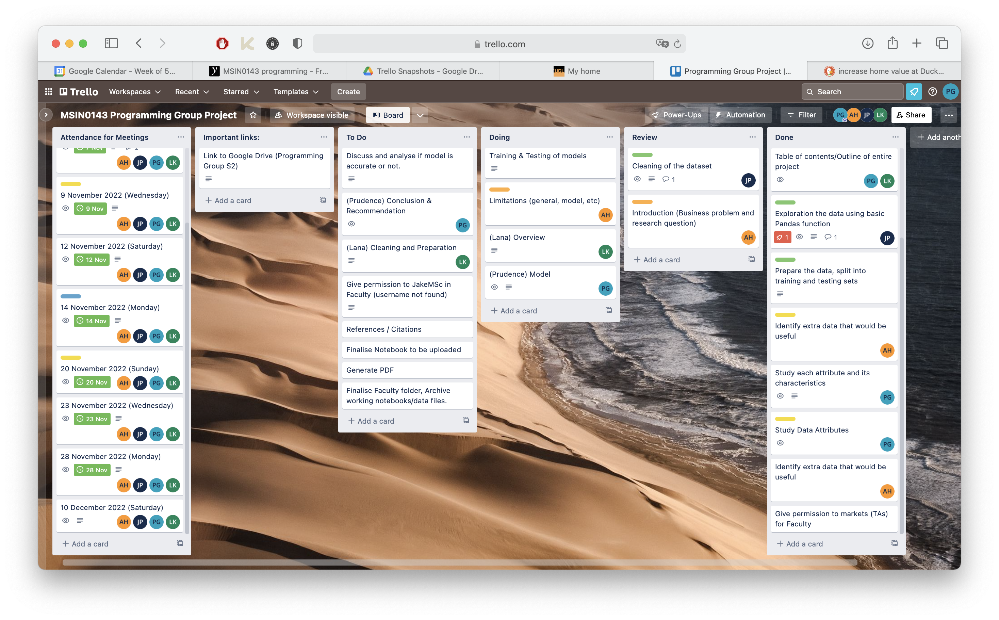

In [10]:
display.Image("/project/Images/Trello_Week11_December 7.png", width=800)

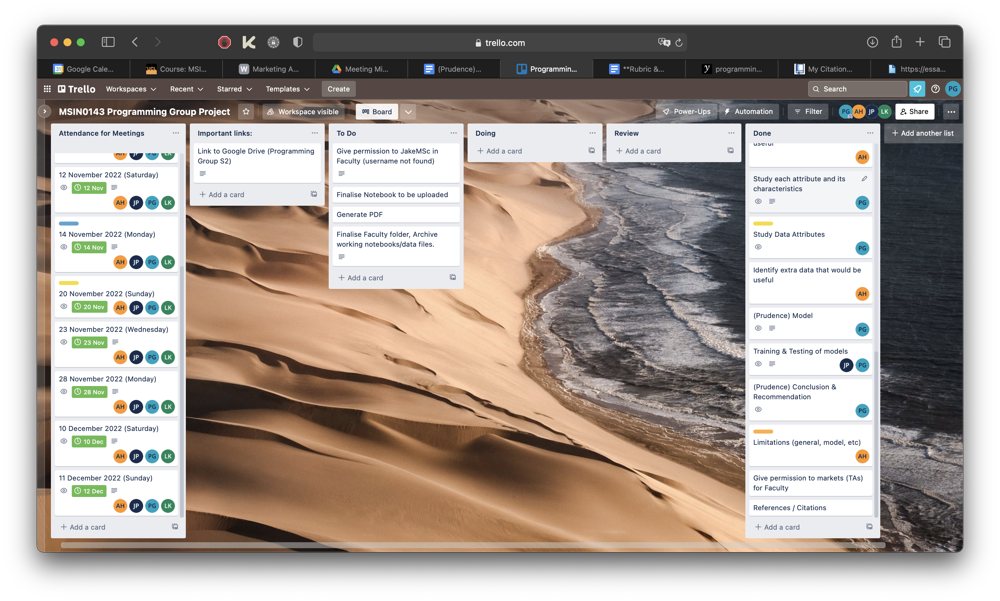

In [11]:
display.Image("/project/Images/Trello_Week11_December 12.png", width = 800)

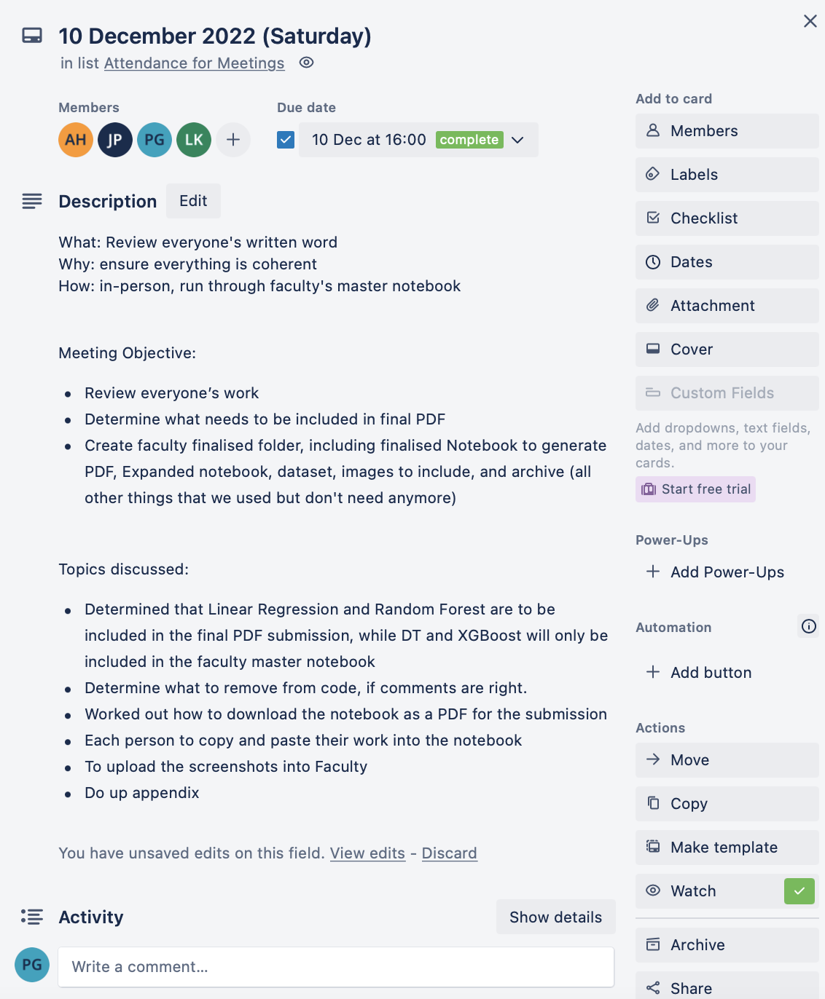

In [276]:
display.Image("/project/Images/Trello_Week10_December 11.png", width=600)

### 7.3 Meeting Minutes <a class="anchor" id="minutes"></a>

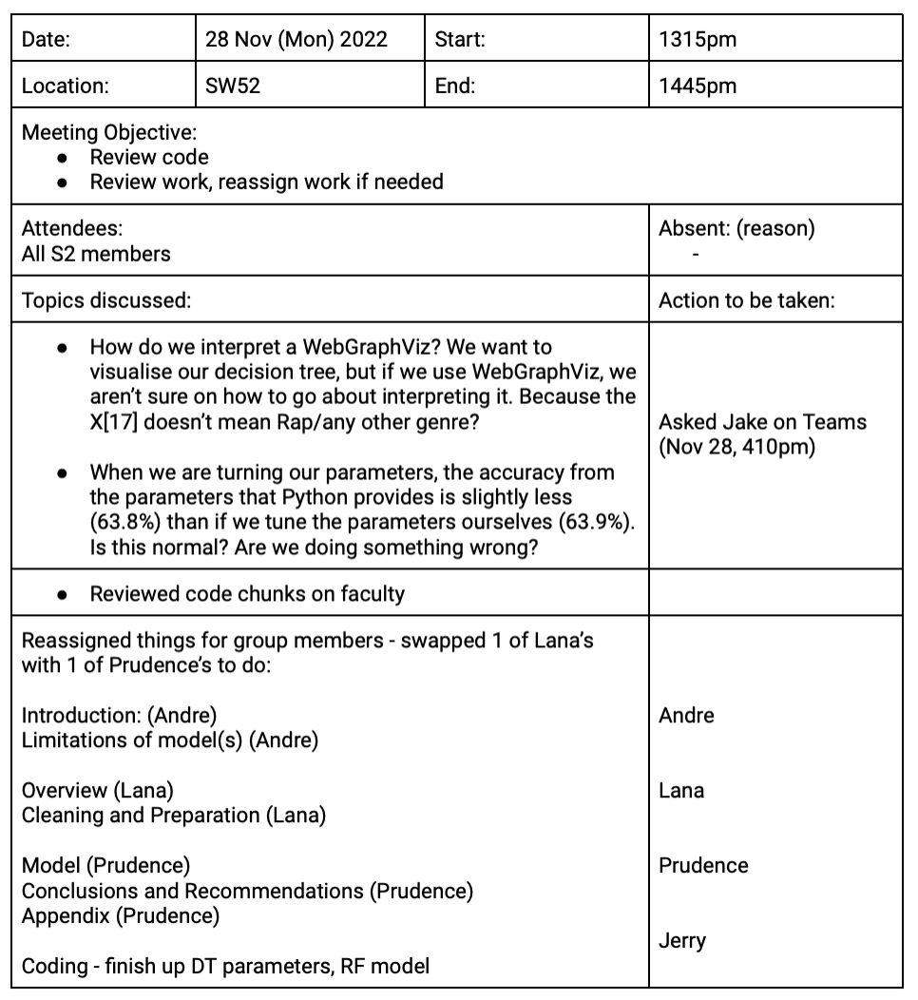

In [275]:
display.Image("/project/Images/Minutes_28Nov.png", width=600)

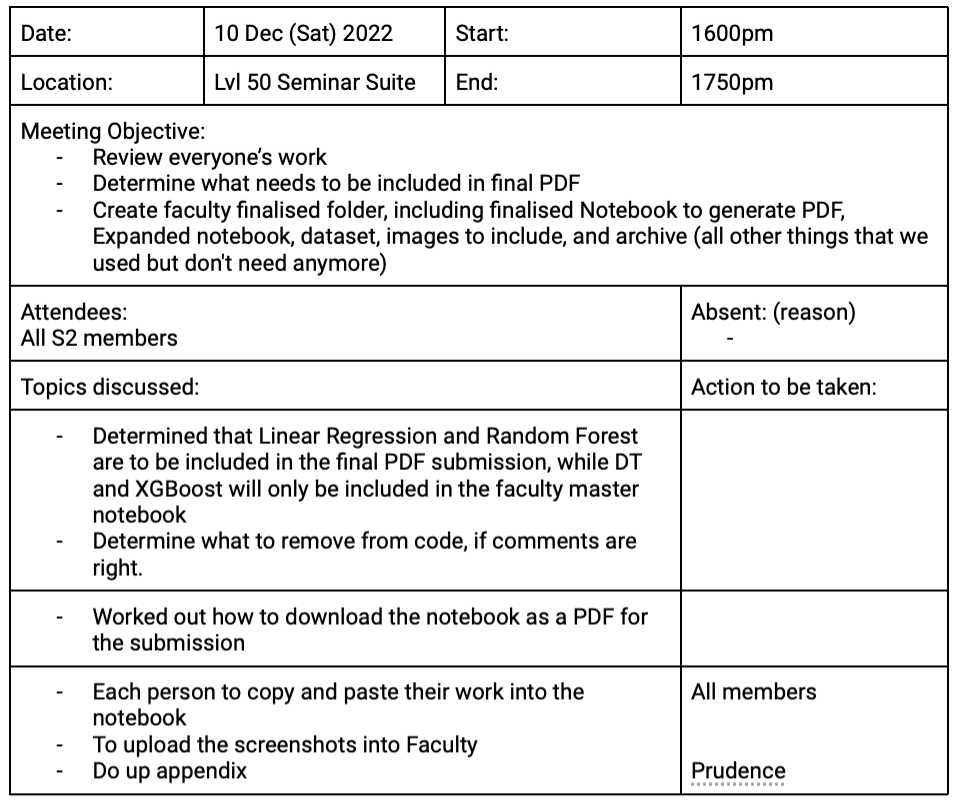

In [274]:
display.Image("/project/Images/Minutes_10Dec.png", width=600)

In [8]:
import xgboost as xgb
!pip install xgboost

/bin/bash: /opt/anaconda/envs/Python3/lib/libtinfo.so.6: no version information available (required by /bin/bash)

         .:::.     .::.       
        ....yy:    .yy.       
        :.  .yy.    y.        
             :y:   .:         
             .yy  .:          
              yy..:           
              :y:.            
              .y.             
             .:.              
        ....:.                
        :::.                  

• Project files and data should be stored in /project. This is shared among everyone
  in the project.
• Personal files and configuration should be stored in /home/faculty.
• Files outside /project and /home/faculty will be lost when this server is terminated.
• Create custom environments to setup your servers reproducibly.

bash: /opt/anaconda/envs/Python3/lib/libtinfo.so.6: no version information available (required by bash)
